In [44]:
# Imports
import Cluster
import csv
import cProfile
import glob
import Loader
import partition
import pickle
import re
import strip
import Visualiser
import numpy as np
import matplotlib.patches as patches
import matplotlib.pyplot as plt
from scipy import stats
from tqdm import tqdm, trange

import pandas as pd
import seaborn as sb
from imblearn.over_sampling import ADASYN, SMOTE
from sklearn.preprocessing import StandardScaler

from shapely.geometry import Point, Polygon, LineString

In [45]:
positive_codes = ["0736", "0711", "0769", "3304", "0793",
                  "3302", "0781", "0747", "3303", "0690",
                  "3305", "0703", "0805", "0733", "3301"]

In [ ]:
def get_tags(hierarchy_tags):
    tags = []
    x_tags, y_tags = [], []

    for tag in hierarchy_tags:
        if "X=" in tag and "Y=" in tag:
            x = tag.split("\"")[1]
            y = tag.split("\"")[3]
            x_tags.append(int(x))
            y_tags.append(int(y))

    for i, j in zip(x_tags, y_tags):
        tags.append((int(i), int(j)))

    return tags


def load_linestring(polygon_file):
    poly = None
    with open(polygon_file, "r") as f:
        hierarchy = f.read()

        p = re.compile("<*")

        hierarchy_tags = p.split(hierarchy)

        tags = get_tags(hierarchy_tags)

        poly = LineString(tags)

    if poly is None:
        raise Exception
    else:
        return poly
    

def load_shape(polygon_file):
    poly = None
    
    with open(polygon_file, "r") as f:
        hierarchy = f.read()

        p = re.compile("<*")

        hierarchy_tags = p.split(hierarchy)

        tags = get_tags(hierarchy_tags)

        poly = Polygon(tags)
        
    if poly is None:
        raise Exception
    else:
        return poly

def get_margin_cells(all_cells, margin_cell_list, shape, my_distance):
    for c in all_cells:
        x_avg, y_avg = np.mean([c[0], c[1]]), np.mean([c[2], c[3]])

        p = Point(x_avg, y_avg)

        if p.distance(shape) <= my_distance:
            margin_cell_list.append(c)

    return margin_cell_list


def get_margin_core_cells(all_cells, shape, line, my_distance):
    margin_cell_list, core_cell_list = [], []

    for cell in all_cells:
        x_avg, y_avg = np.mean([cell[0], cell[1]]), np.mean([cell[2], cell[3]])

        p = Point(x_avg, y_avg)

        if p.distance(line) <= my_distance:
            margin_cell_list.append(cell)
        elif p.within(shape):
            core_cell_list.append(cell)

    return margin_cell_list, core_cell_list


def get_lymphocytes_on_margin(cd3cd8, annotations_file):
    all_cd3, all_cd8 = cd3cd8

    poly = load_linestring(annotations_file)

    margin_cd3, margin_cd8 = [], []

    margin_cd3, margin_cd8 = np.asarray(get_margin_cells(all_cd3, margin_cd3, poly, 500)), np.asarray(get_margin_cells(all_cd8, margin_cd8, poly, 500))

    return margin_cd3, margin_cd8


def get_lymphocytes_on_margin_and_core(cd3cd8, annotations_file):
    all_cd3, all_cd8 = cd3cd8
    
    shape = load_shape(annotations_file)
    line = load_linestring(annotations_file)
    
    margin_cd3, core_cd3 = get_margin_core_cells(all_cd3, shape, line, 500)
    margin_cd8, core_cd8 = get_margin_core_cells(all_cd8, shape, line, 500)
            
    return np.asarray(margin_cd3), np.asarray(core_cd3), np.asarray(margin_cd8), np.asarray(core_cd8)


def get_heatmaps(m=114, d=50, t=886, cluster_size_range=[1, 2, 3, 4], display_plot=False, metric_tiling=True,
                 pretty_print=False, take_lymphocyte_density=True, take_cd3_density=True, take_cd8_density=True,
                 as_histogram=False, num_bins=20):

    if pretty_print:
        print("density type set...")

    print("file not found - extracting objects...")

    X = np.empty((m * 6), dtype=object)
    y = np.zeros([m, 1], dtype=int)
    positives = []

    Cluster.set_d(d)

    # Doing these file-pairs one at a time - they take up an insane amount of space!
    # We have a HUGE number of these lymphocytes.
    all_count = 0
    for (i, lymph_name), (j, cluster_name), (k, annotations_name) in tqdm(zip(enumerate(sorted(glob.glob("./lymphocytes/*.csv"))),
                                                                          enumerate(sorted(glob.glob("./LargerDataset/*.p"))),
                                                                          enumerate(sorted(glob.glob("./Daniel line/*.annotations"))))):
        lymph_code = lymph_name.split('/')[-1][0:-4].split("__")
        cluster_code = cluster_name.split('/')[-1][0:-2].split("__")
        annotations_code = annotations_name.lower().split('/')[-1].split('.')[0].replace("(ext)", "")[-4:].upper()

        # No SN-- files are positive in our dataset - ignore these for potential positives
        if len(lymph_code) == len(cluster_code) and len(lymph_code) > 1:
            lymph_code = lymph_code[1][0:4]
            cluster_code = cluster_code[1][0:4]
            if lymph_code in positive_codes and lymph_code == cluster_code:
                positives.append(i)
                y[i] = 1

        print("################### CODES ###################")
        print(lymph_code)
        print(cluster_code)
        print(annotations_code)
        print("################### CODES ###################")

        all_cd3, all_cd8 = Loader.load_split(lymph_name.split('/')[-1][0:-4], "./lymphocytes/", input_type="lymphocyte", pretty_print=pretty_print)

        print(type(all_cd3), type(all_cd8))
        print(all_cd3[0], all_cd8[0])

        Visualiser.visualise_lymphocytes(all_cd3, all_cd8)

        margin_cd3, core_cd3, margin_cd8, core_cd8 = get_lymphocytes_on_margin_and_core(Loader.load_split(lymph_name.split('/')[-1][0:-4], "./lymphocytes/", input_type="lymphocyte", pretty_print=pretty_print), annotations_name)

        print(type(margin_cd3), type(core_cd3), type(margin_cd8), type(core_cd8))
        print(margin_cd3[0], core_cd3[0], margin_cd8, core_cd8[0])

        Visualiser.visualise_lymphocytes(margin_cd3, margin_cd8)
        Visualiser.visualise_lymphocytes(core_cd3, core_cd8)

        # Add the cluster class column
        margin_cd3 = np.concatenate((margin_cd3, np.zeros((margin_cd3.shape[0], 1))), axis=1)
        margin_cd8 = np.concatenate((margin_cd8, np.zeros((margin_cd8.shape[0], 1))), axis=1)

        print(type(margin_cd3), type(core_cd3))
        print(type(margin_cd8), type(core_cd8))

        core_cd3 = np.concatenate((core_cd3, np.zeros((core_cd3.shape[0], 1))), axis=1)
        core_cd8 = np.concatenate((core_cd8, np.zeros((core_cd8.shape[0], 1))), axis=1)

        # Combine all of them together
        margin_items = np.concatenate((margin_cd3, margin_cd8))
        core_items = np.concatenate((core_cd3, core_cd8))

        partitioned_margin_items, tiles, lymph_w, lymph_h, \
            clust_w, clust_h, x_step, y_step = partition.partition(margin_items, tile_size=t, to_list=True, input_type="mixed", by_metric=metric_tiling, scale=1)

        partitioned_core_items, tiles, lymph_w, lymph_h, \
            clust_w, clust_h, x_step, y_step = partition.partition(core_items, tile_size=t, to_list=True, input_type="mixed", by_metric=metric_tiling, scale=1)            
            
        partitioned_margin_cd3 = np.zeros(partitioned_margin_items.shape, dtype=int)
        partitioned_margin_cd8 = np.zeros(partitioned_margin_items.shape, dtype=int)
        partitioned_margin_cd3cd8 = np.zeros(partitioned_margin_items.shape, dtype=int)

        partitioned_core_cd3 = np.zeros(partitioned_core_items.shape, dtype=int)
        partitioned_core_cd8 = np.zeros(partitioned_core_items.shape, dtype=int)
        partitioned_core_cd3cd8 = np.zeros(partitioned_core_items.shape, dtype=int)

        (width, height) = partitioned_margin_items.shape
        (width_, height_) = partitioned_core_items.shape
        
        for col in range(width):
            for row in range(height):
                lymphocyte_cells = partitioned_margin_items[col][row][0]  # lymphocytes
                partitioned_margin_cd3cd8[col][row] += len(lymphocyte_cells)
                for cell in lymphocyte_cells:
                    if cell[4] > 0:
                        partitioned_margin_cd3[col][row] += 1
                    elif cell[5] > 0:
                        partitioned_margin_cd8[col][row] += 1

        for col in range(width_):
            for row in range(height_):
                lymphocyte_cells = partitioned_core_items[col][row][0]  # lymphocytes
                partitioned_core_cd3cd8[col][row] += len(lymphocyte_cells)
                for cell in lymphocyte_cells:
                    if cell[4] > 0:
                        partitioned_core_cd3[col][row] += 1
                    elif cell[5] > 0:
                        partitioned_core_cd8[col][row] += 1

        partitioned_margin_cd3 = np.flip(np.rot90(partitioned_margin_cd3), 0)
        partitioned_margin_cd8 = np.flip(np.rot90(partitioned_margin_cd8), 0)
        partitioned_margin_cd3cd8 = np.flip(np.rot90(partitioned_margin_cd3cd8), 0)
        
        partitioned_core_cd3 = np.flip(np.rot90(partitioned_core_cd3), 0)
        partitioned_core_cd8 = np.flip(np.rot90(partitioned_core_cd8), 0)
        partitioned_core_cd3cd8 = np.flip(np.rot90(partitioned_core_cd3cd8), 0)

        if display_plot:
            with sb.axes_style("white"):
                sb.heatmap(partitioned_margin_cd3, cmap="hot")
                plt.show()
                sb.heatmap(partitioned_margin_cd8, cmap="hot")
                plt.show()
                sb.heatmap(partitioned_margin_cd3cd8, cmap="hot")
                plt.show()
                sb.heatmap(partitioned_core_cd3, cmap="hot")
                plt.show()
                sb.heatmap(partitioned_core_cd8, cmap="hot")
                plt.show()
                sb.heatmap(partitioned_core_cd3cd8, cmap="hot")
                plt.show()

        X[all_count + 0] = partitioned_margin_cd3
        X[all_count + 1] = partitioned_margin_cd8
        X[all_count + 2] = partitioned_margin_cd3cd8
        X[all_count + 3] = partitioned_core_cd3
        X[all_count + 4] = partitioned_core_cd8
        X[all_count + 5] = partitioned_core_cd3cd8
        all_count += 6

    dataset = {"X": X, "y": y, "t": t, "d": d, "range": cluster_size_range}

    pickle.dump(dataset, open("lymphocyte_density_heatmaps_" + str(t) + "_" + str(d) + "_" + str(cluster_size_range) + ".p", "wb"))

    if as_histogram:
        return get_histogram_of_heatmap(X, m * 6, num_bins), y, t, d, cluster_size_range

    return X, y, t, d, cluster_size_range



0it [00:00, ?it/s]

file not found - extracting objects...
################### CODES ###################
0690
0690
0690
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[24632 24654   192   216     1     0] [24702 24726   328   352     0     1]


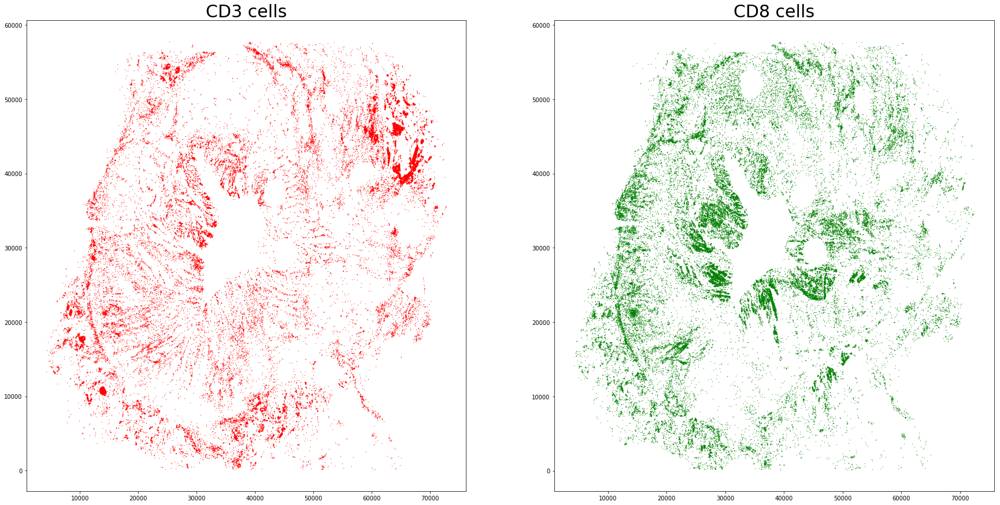

/Users/soutar/miniconda3/envs/ML/lib/python3.6/site-packages/ipykernel_launcher.py:45: FutureWarning: split() requires a non-empty pattern match.
/Users/soutar/miniconda3/envs/ML/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: split() requires a non-empty pattern match.


<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[39214 39234   954   976     1     0] [36606 36646   758   796     1     1] [[37720 37740   250   272     0     1]
 [37658 37676   760   782     0     1]
 [37782 37814   794   834     0     1]
 ...
 [38796 38852 56936 56974     0     1]
 [38442 38464 56986 57006     0     1]
 [38982 38998 56276 56286     0     1]] [36656 36680   774   800     0     1]


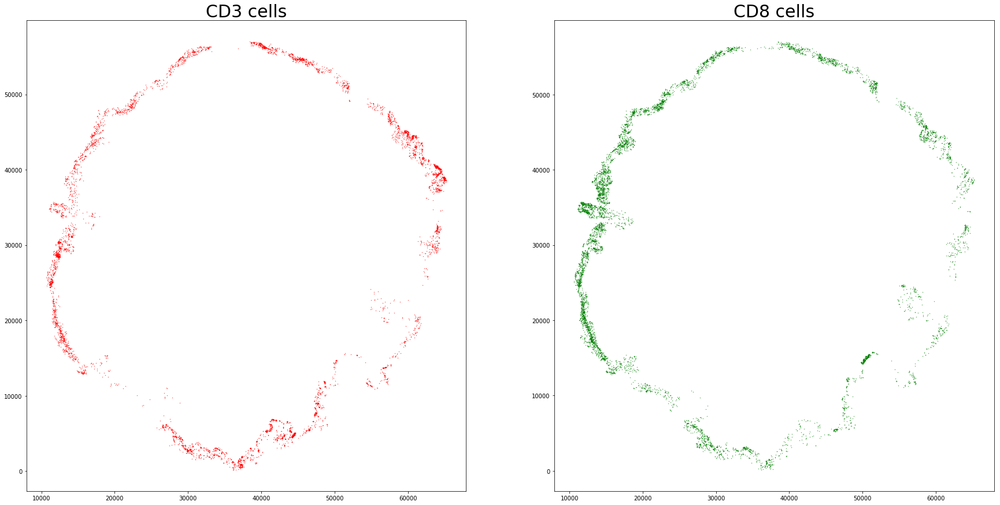

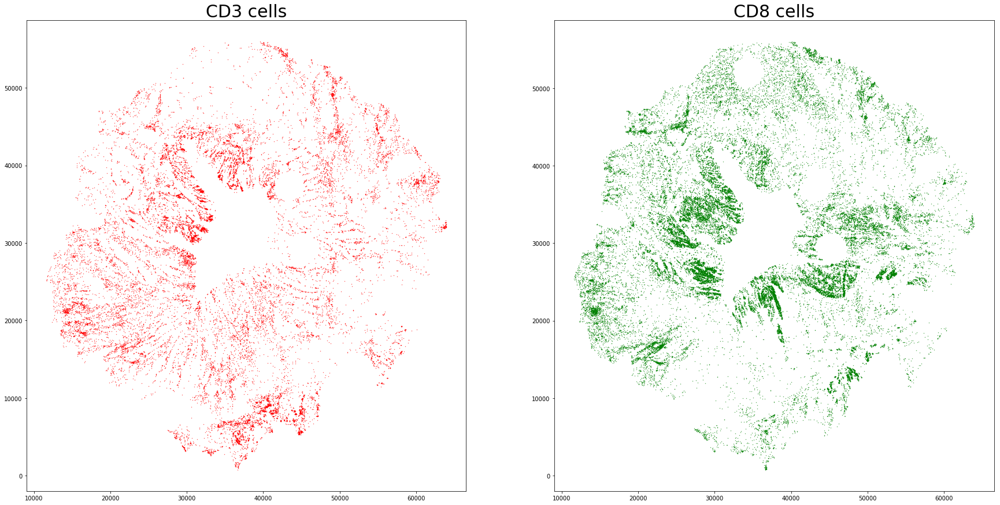

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 60/60 [00:01<00:00, 49.88it/s]

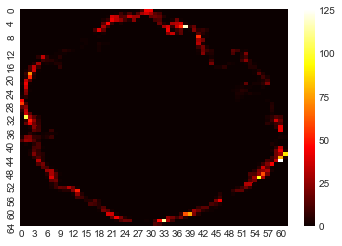

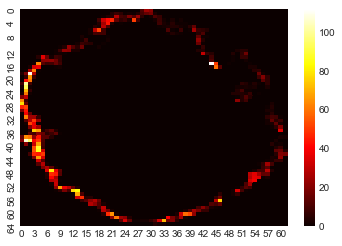

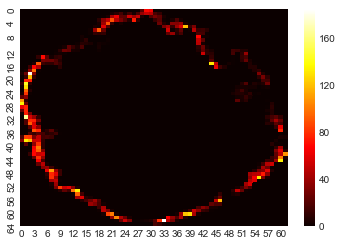

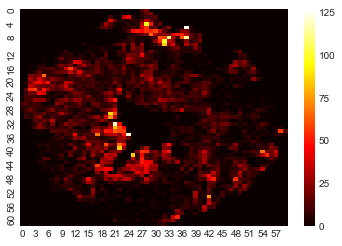

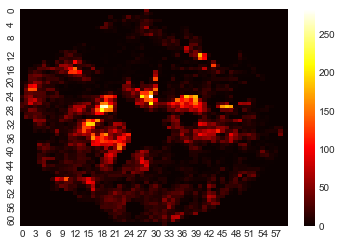

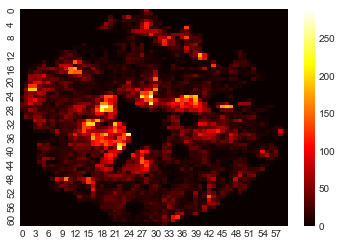

1it [04:06, 246.25s/it]

################### CODES ###################
0691
0691
0691
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[7246 7260   49   71    1    0] [6946 6972  937  957    0    1]


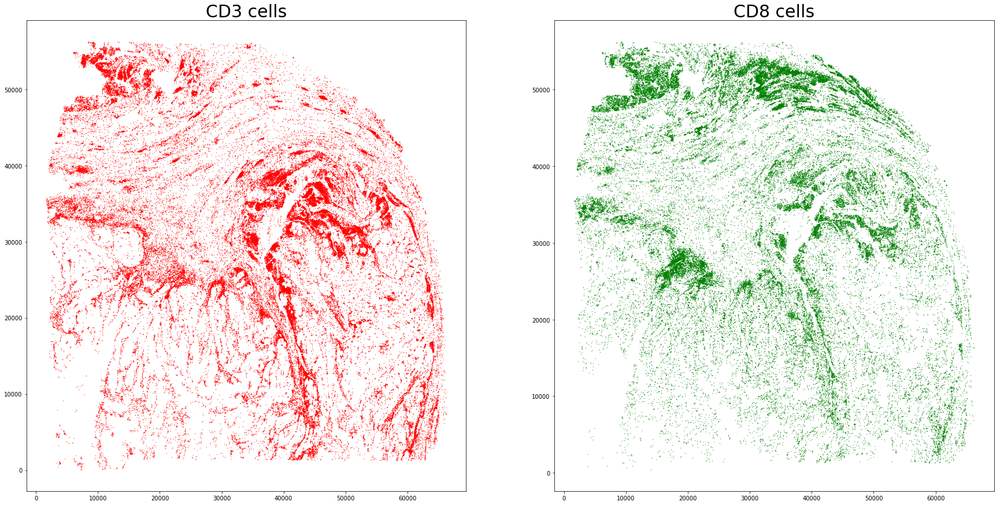

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[60682 60690  1527  1535     1     0] [7246 7260   49   71    1    0] [[60670 60694  1357  1391     0     1]
 [60690 60714  1443  1457     0     1]
 [61580 61604  1487  1515     0     1]
 ...
 [43062 43100 42495 42521     0     1]
 [43050 43084 42563 42581     0     1]
 [42504 42532 42603 42631     0     1]] [6946 6972  937  957    0    1]


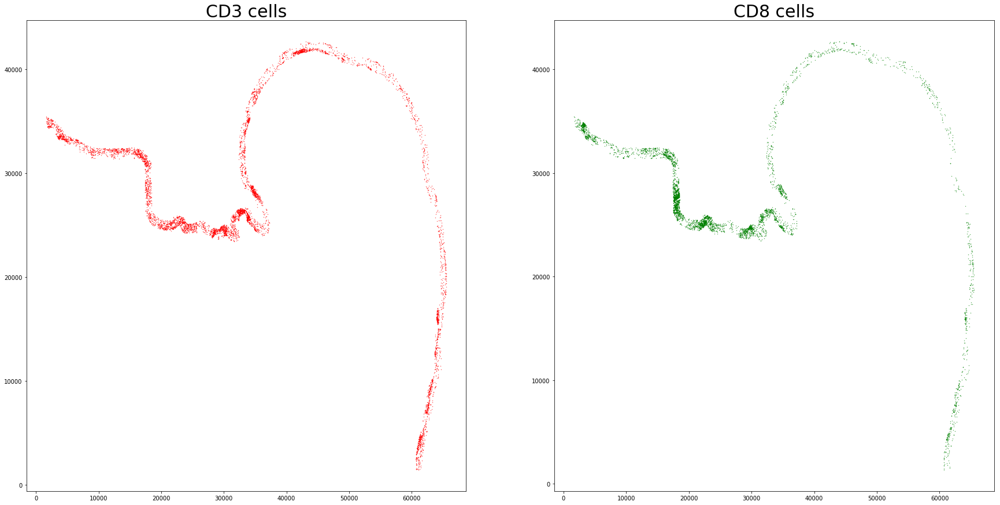

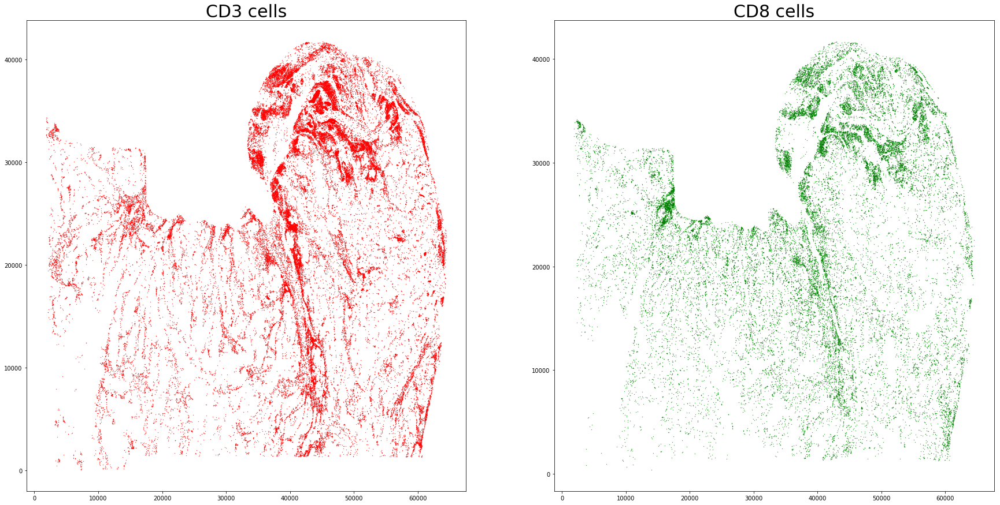


  0%|          | 0/73 [00:00<?, ?it/s]

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 71/71 [00:01<00:00, 46.59it/s]

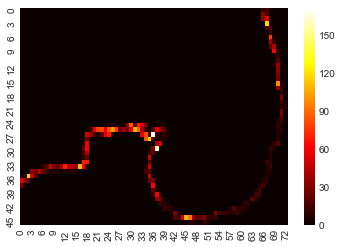

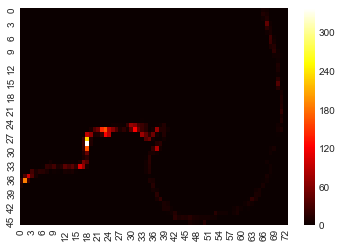

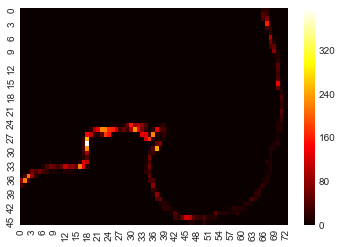

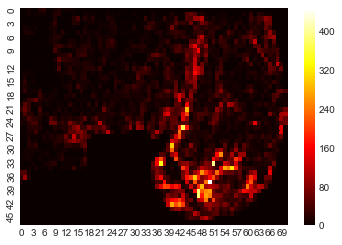

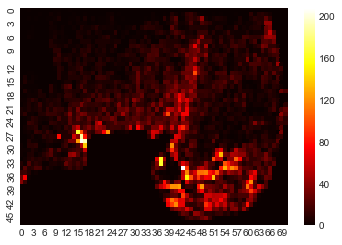

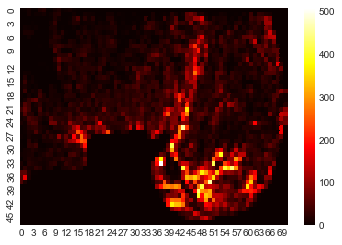

2it [05:37, 168.84s/it]

################### CODES ###################
0692
0692
0692
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[13217 13241  1563  1605     1     0] [15109 15137  1513  1533     0     1]


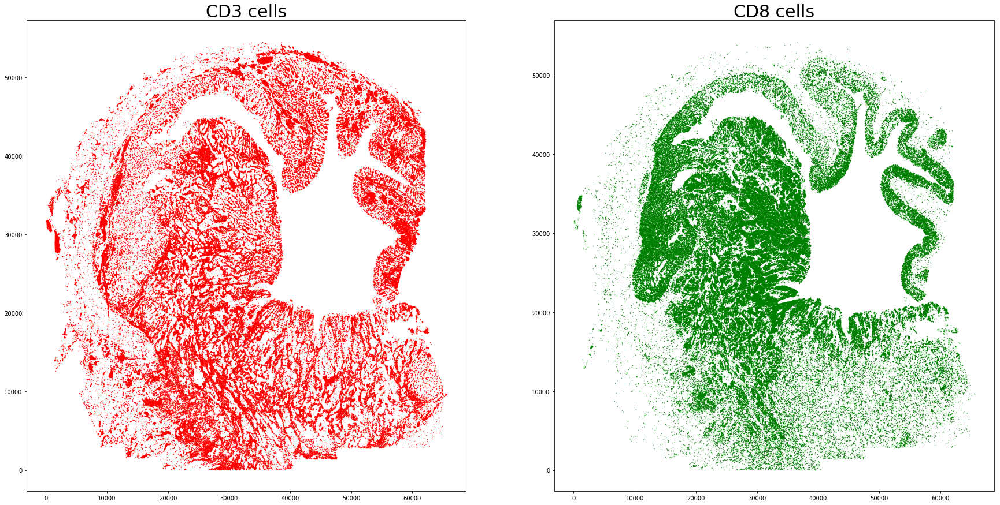

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[26537 26561    57    77     1     0] [26873 26907  1619  1649     1     0] [[27109 27129    55    75     0     1]
 [26591 26621    67    87     0     1]
 [26655 26697    65    95     0     1]
 ...
 [32249 32281 43617 43639     0     1]
 [28819 28839 44865 44885     0     1]
 [28701 28731 44975 44997     0     1]] [29351 29379   761   787     0     1]


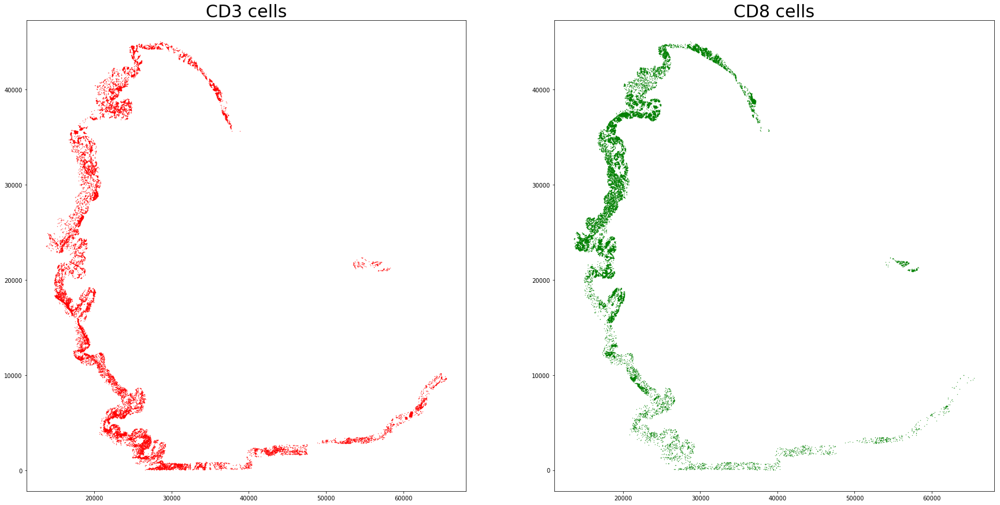

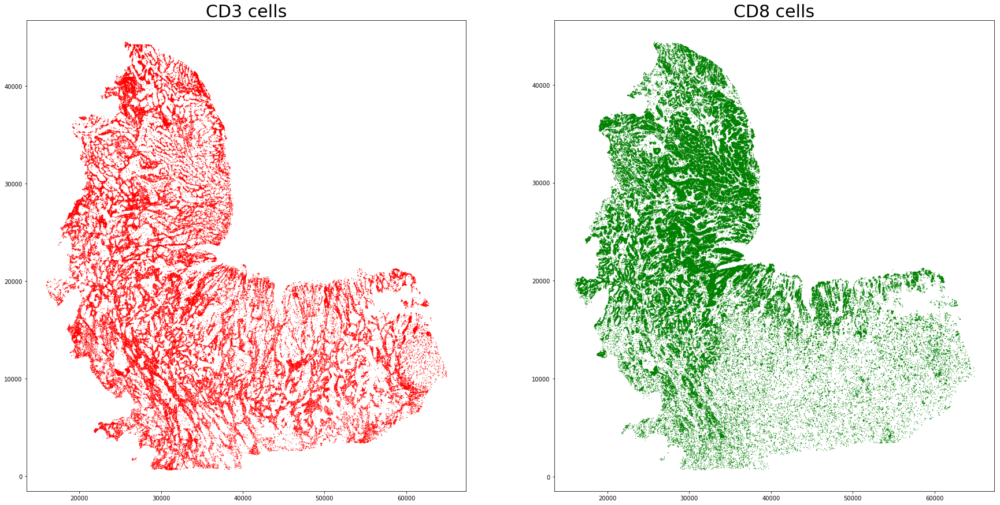

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 56/56 [00:04<00:00, 12.07it/s]

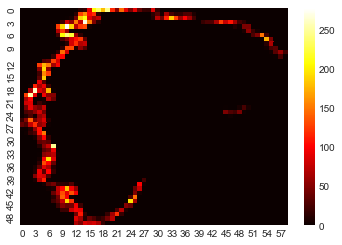

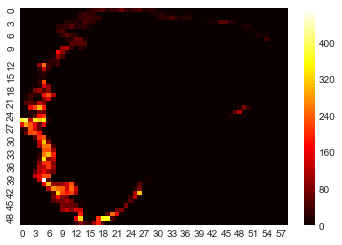

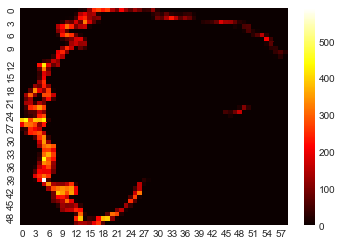

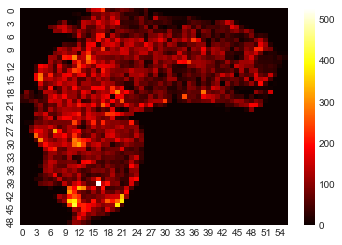

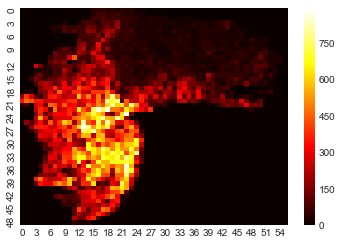

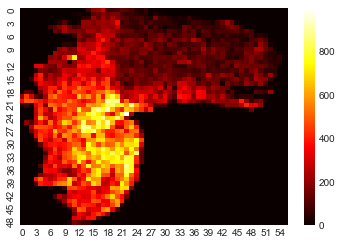

3it [42:20, 846.88s/it]

################### CODES ###################
0693
0693
0693
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[11274 11342   580   658     1     0] [16476 16498  1184  1208     0     1]


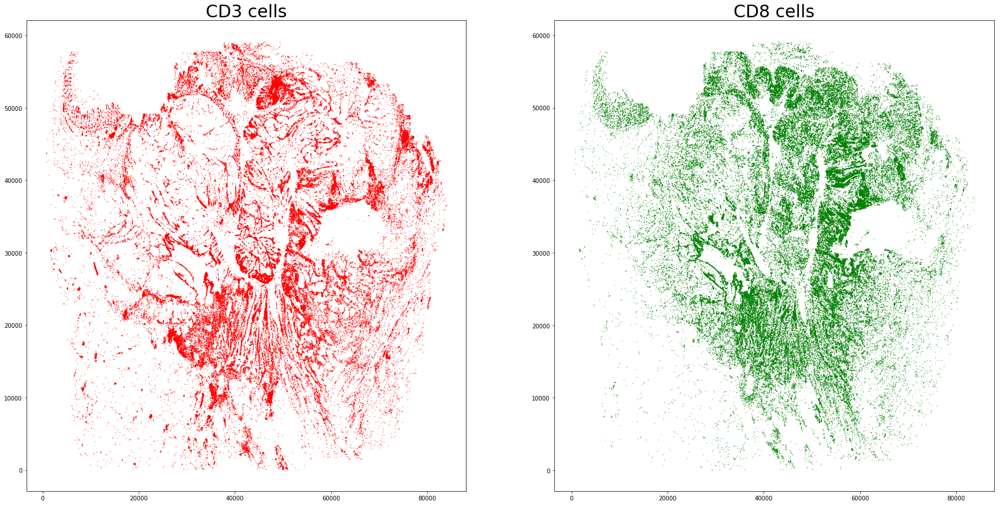

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[54358 54398   662   684     1     0] [56230 56258  3086  3114     1     0] [[58972 59002  1578  1610     0     1]
 [59058 59082  1598  1624     0     1]
 [58938 58972  1600  1620     0     1]
 ...
 [31984 31998 57732 57740     0     1]
 [31864 31908 57698 57762     0     1]
 [38516 38536 57686 57708     0     1]] [57340 57392  1974  2004     0     1]


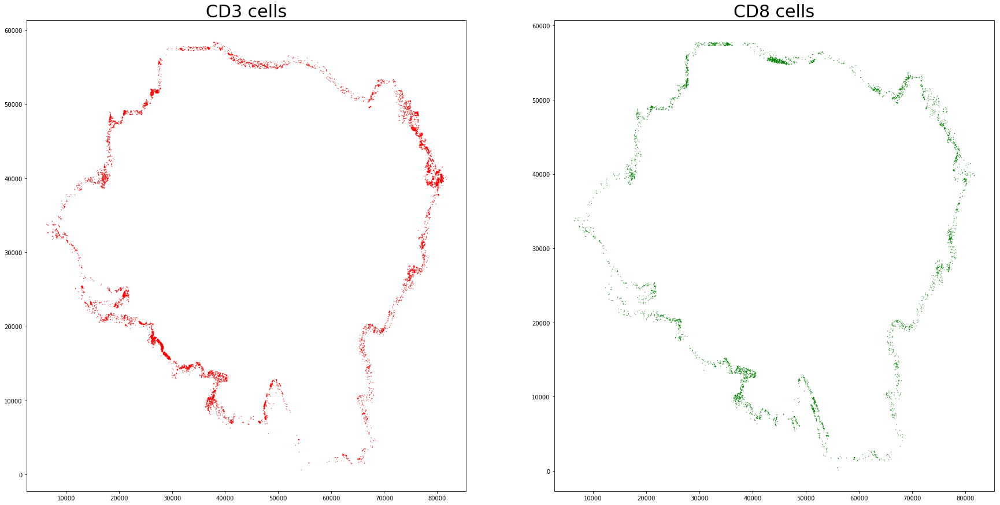

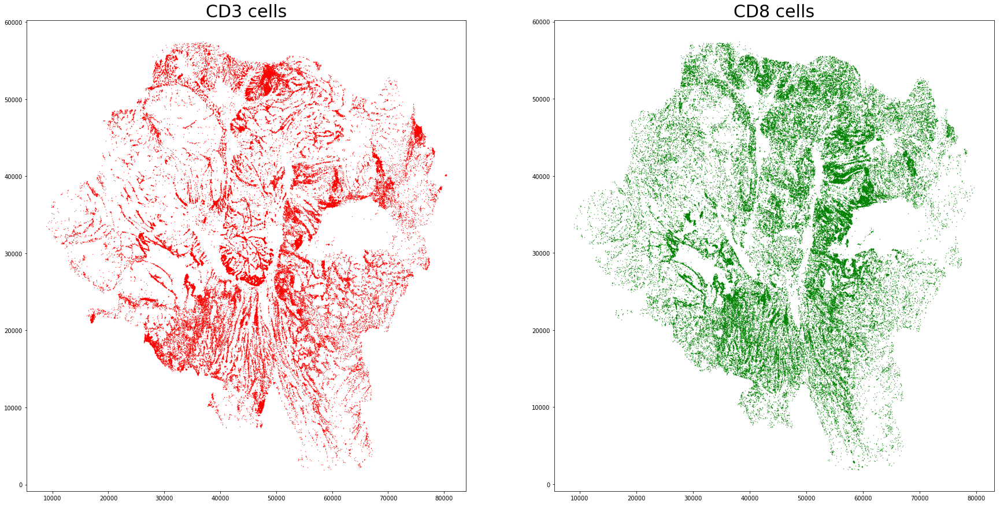

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 81/81 [00:04<00:00, 19.64it/s]


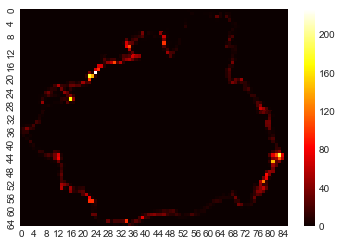

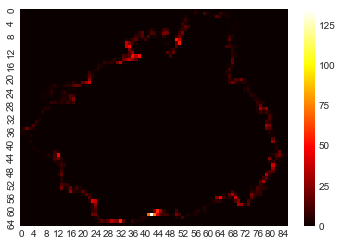

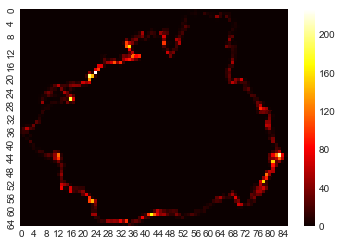

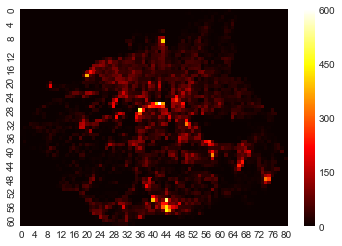

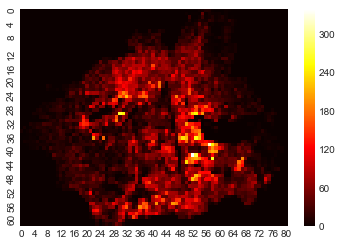

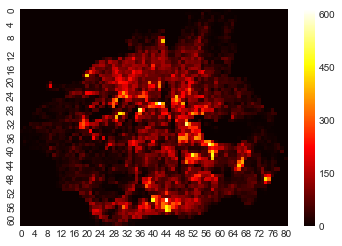

4it [48:13, 723.30s/it]

################### CODES ###################
0694
0694
0694
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[11840 11890  1582  1622     1     0] [12600 12618  1582  1588     0     1]


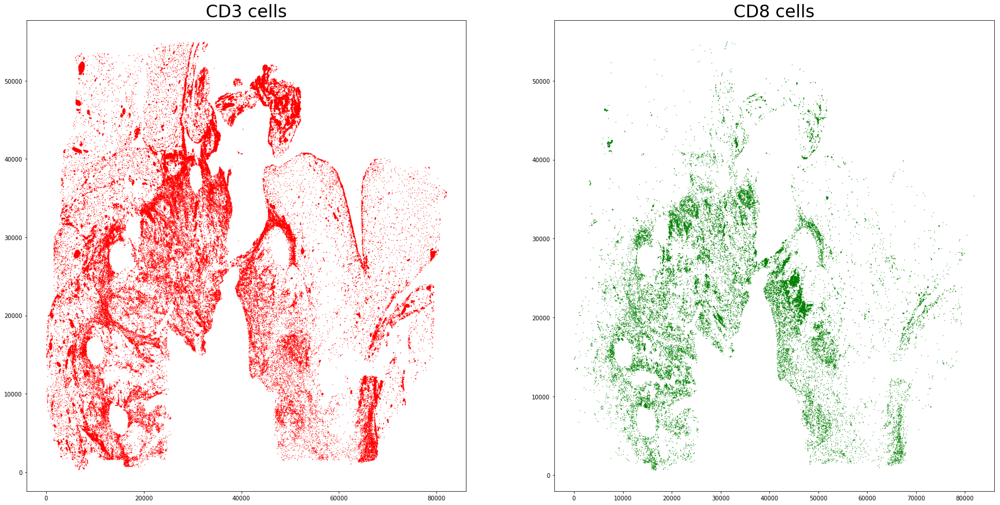

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[20806 20830  1652  1674     1     0] [18550 18576  1364  1390     1     0] [[24228 24248  1676  1696     0     1]
 [23856 23888  1682  1696     0     1]
 [23854 23906  1682  1718     0     1]
 ...
 [34070 34100 45400 45430     0     1]
 [34080 34102 45432 45466     0     1]
 [34066 34078 45440 45466     0     1]] [18042 18076  1236  1260     0     1]


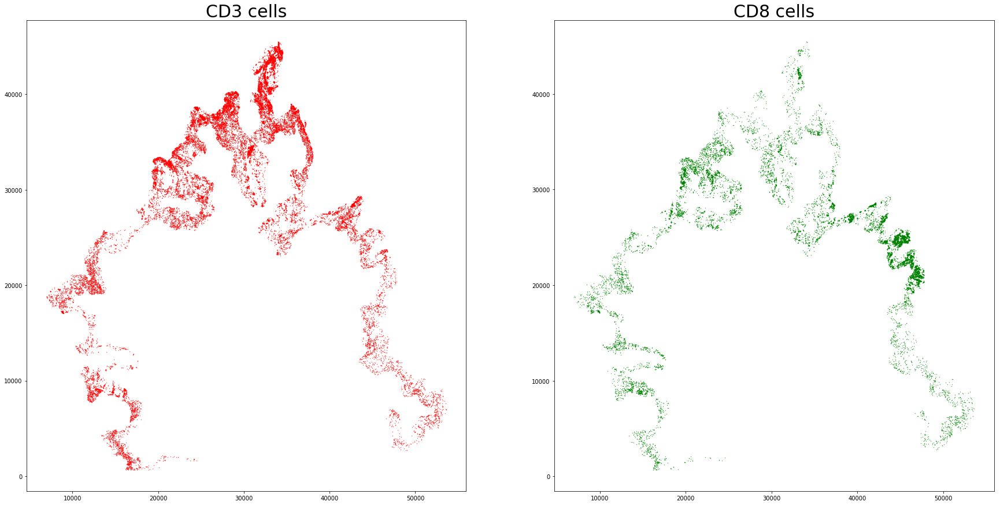

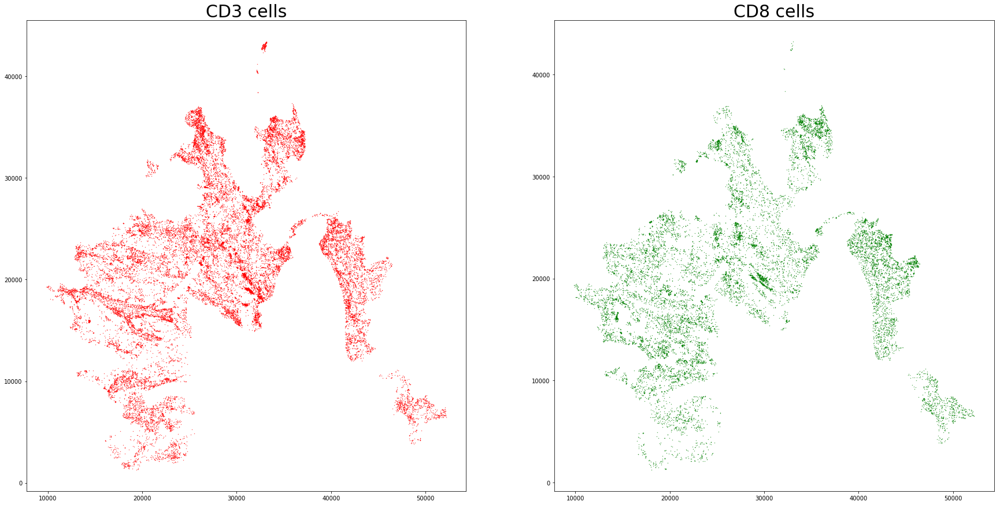

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 48/48 [00:00<00:00, 94.24it/s]

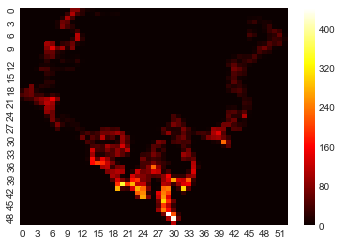

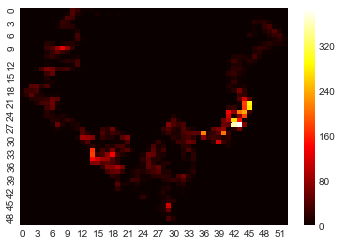

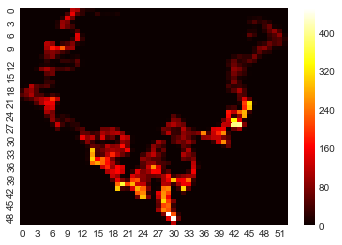

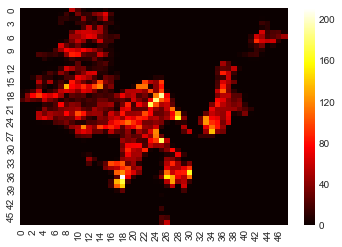

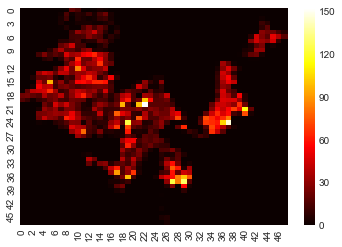

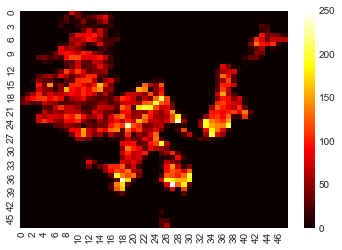

5it [1:05:50, 790.02s/it]

################### CODES ###################
0695
0695
0695
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[9212 9236 1594 1620    1    0] [12978 12998   444   468     0     1]


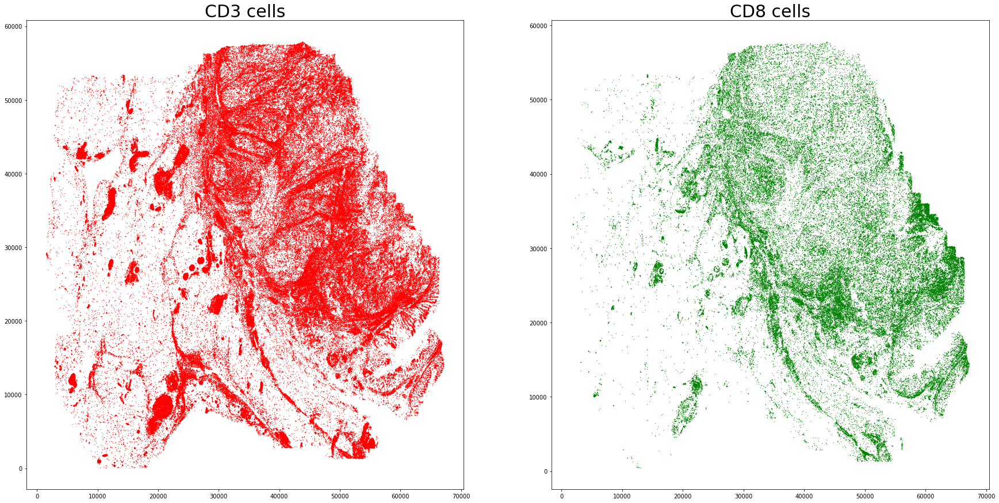

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[55274 55316 20172 20210     1     0] [53874 53906 21490 21530     1     0] [[55122 55152 20180 20204     0     1]
 [55170 55196 20182 20202     0     1]
 [54844 54900 20186 20222     0     1]
 ...
 [32290 32314 57204 57226     0     1]
 [32264 32284 57206 57222     0     1]
 [32404 32412 57272 57284     0     1]] [53974 53990 21490 21504     0     1]


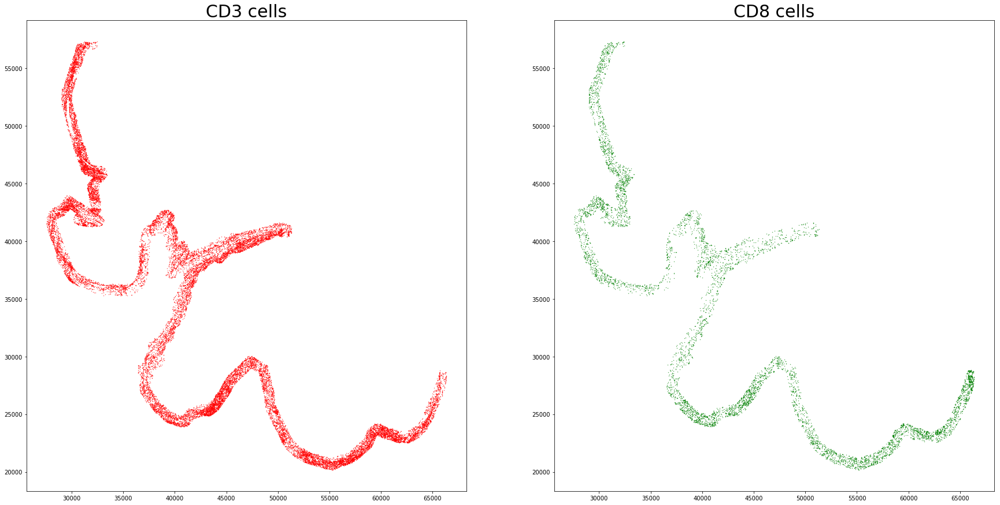

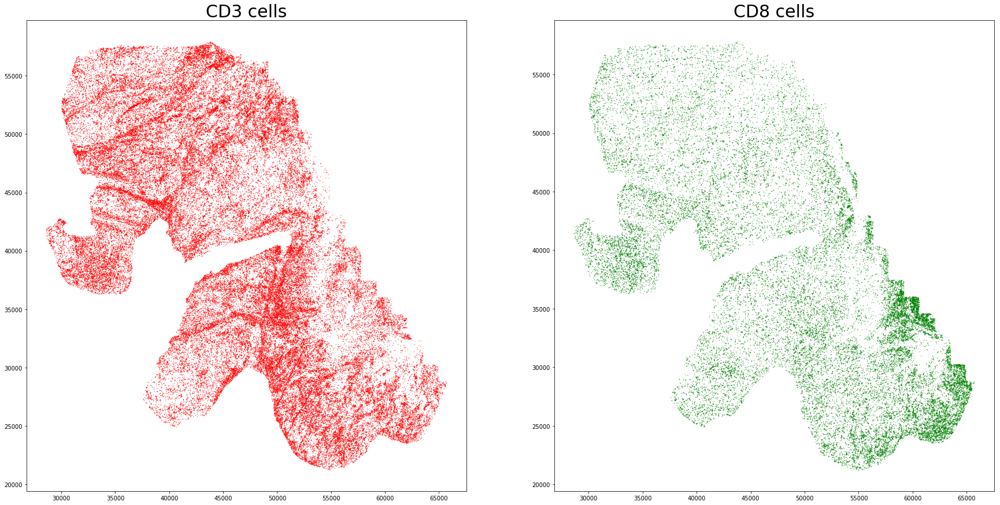

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 42/42 [00:01<00:00, 37.38it/s]

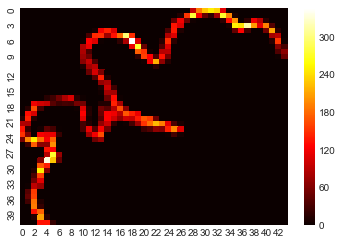

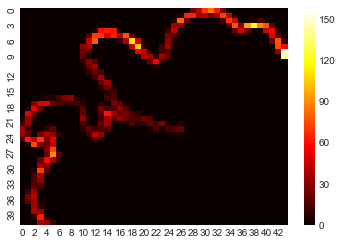

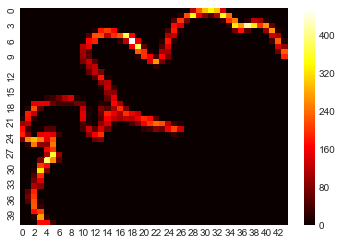

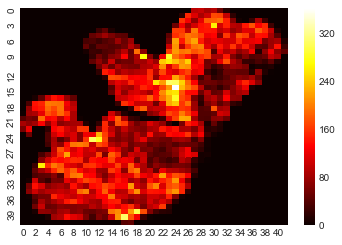

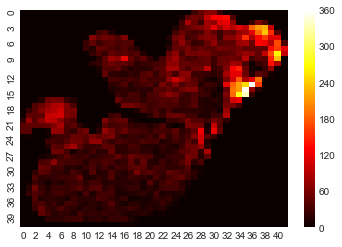

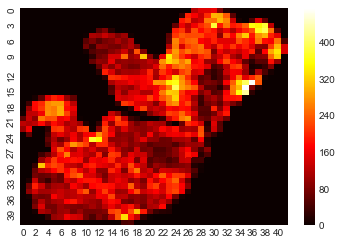

6it [1:08:46, 687.70s/it]

################### CODES ###################
0696
0696
0696
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[11166 11178  1673  1687     1     0] [14344 14378  1507  1539     0     1]


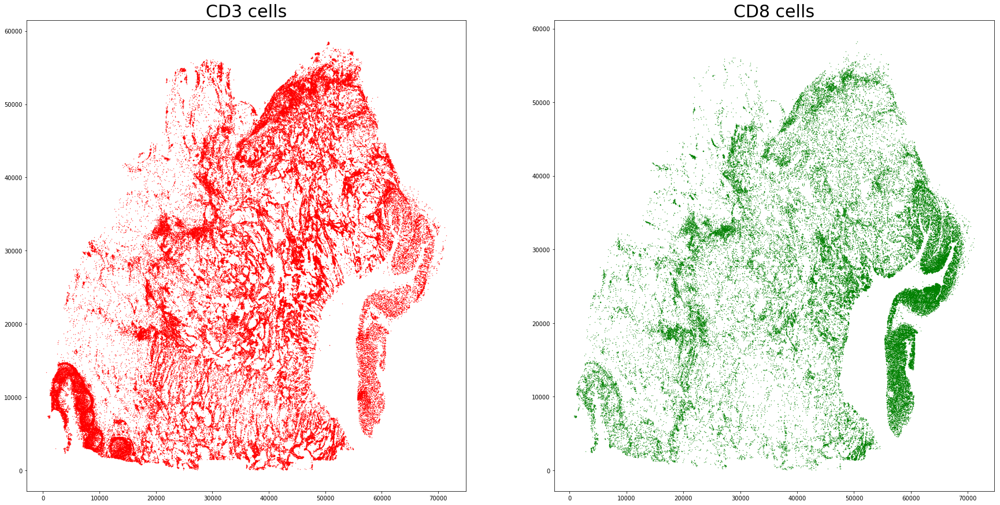

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[18474 18512  1085  1123     1     1] [20296 20328   955   987     1     0] [[18212 18236  1125  1151     0     1]
 [18886 18918  1139  1163     0     1]
 [18592 18632  1141  1169     0     1]
 ...
 [53846 53854 53945 53951     0     1]
 [53218 53246 54007 54031     0     1]
 [53528 53560 54007 54049     0     1]] [19846 19874  1065  1091     0     1]


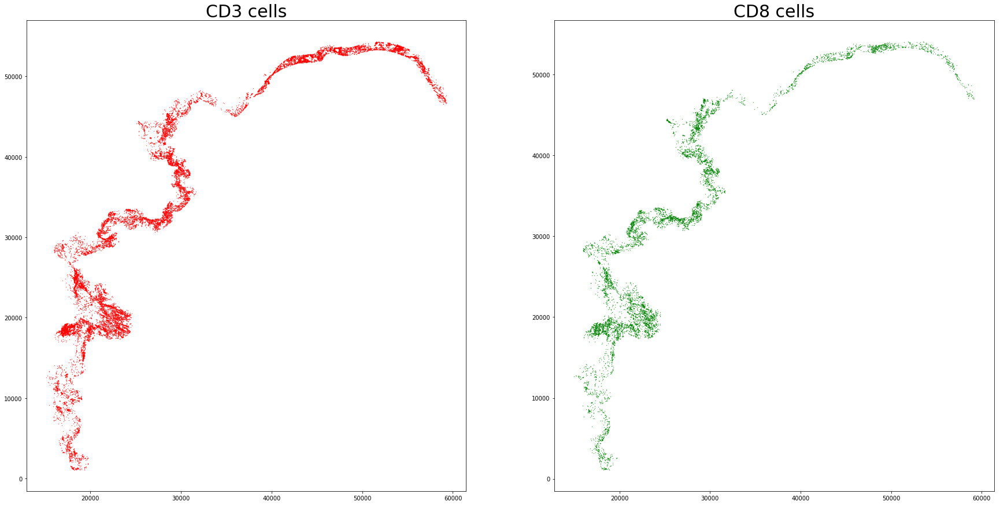

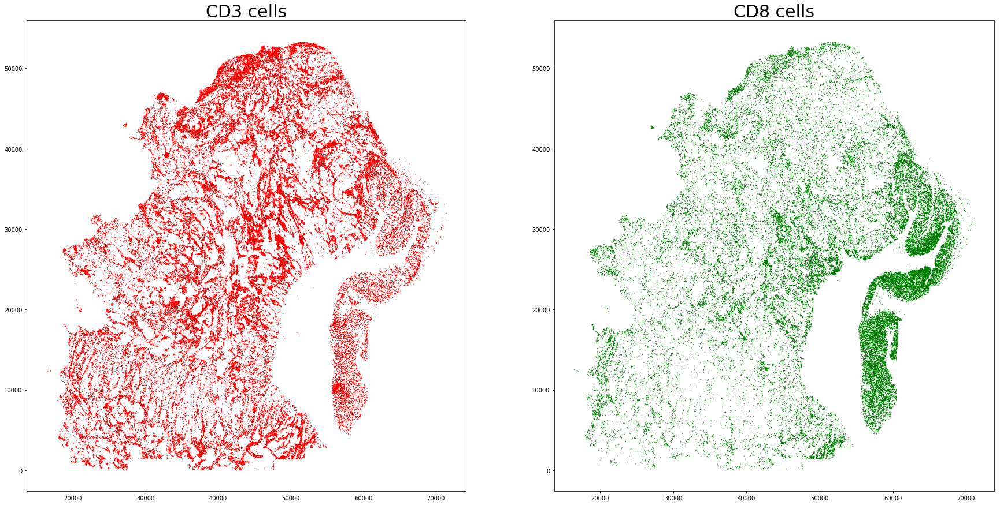

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 63/63 [00:03<00:00, 17.62it/s]

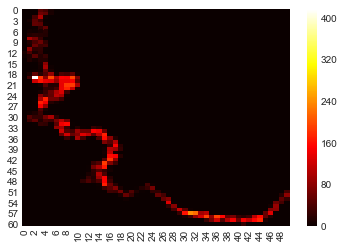

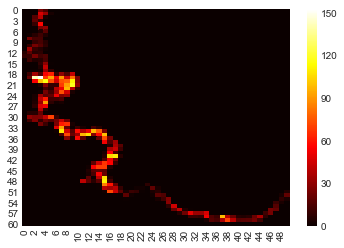

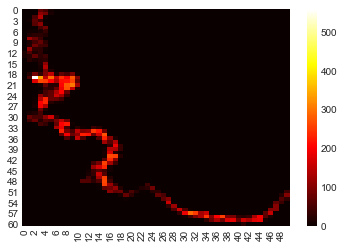

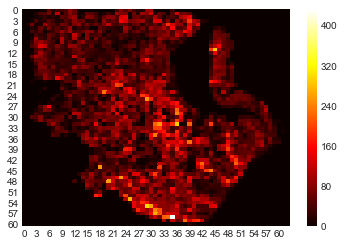

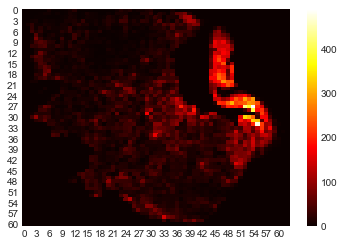

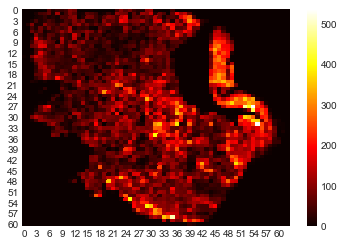

7it [1:15:13, 644.73s/it]

################### CODES ###################
0697
0697
0697
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[15041 15073    69    91     1     0] [14707 14745    39    83     0     1]


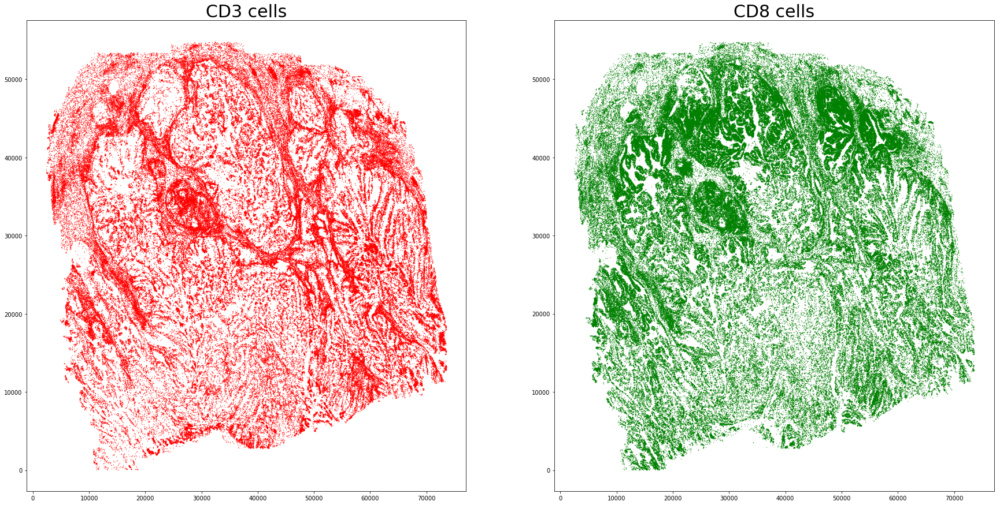

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[13965 13987 15847 15867     1     0] [15041 15073    69    91     1     0] [[13897 13935 15757 15821     0     1]
 [14011 14059 15869 15901     0     1]
 [14123 14155 15869 15899     0     1]
 ...
 [32377 32403 53185 53205     0     1]
 [31589 31621 53313 53333     0     1]
 [31633 31663 53403 53425     0     1]] [14707 14745    39    83     0     1]


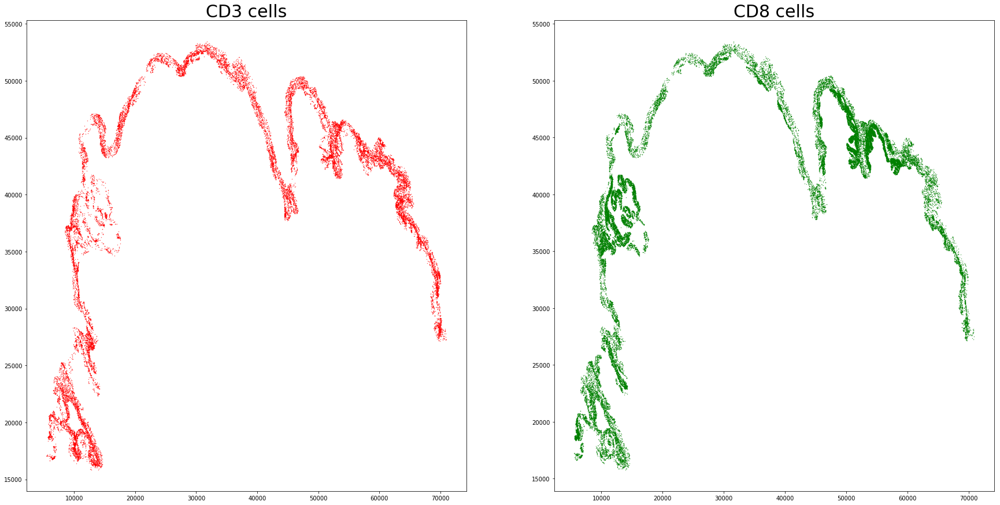

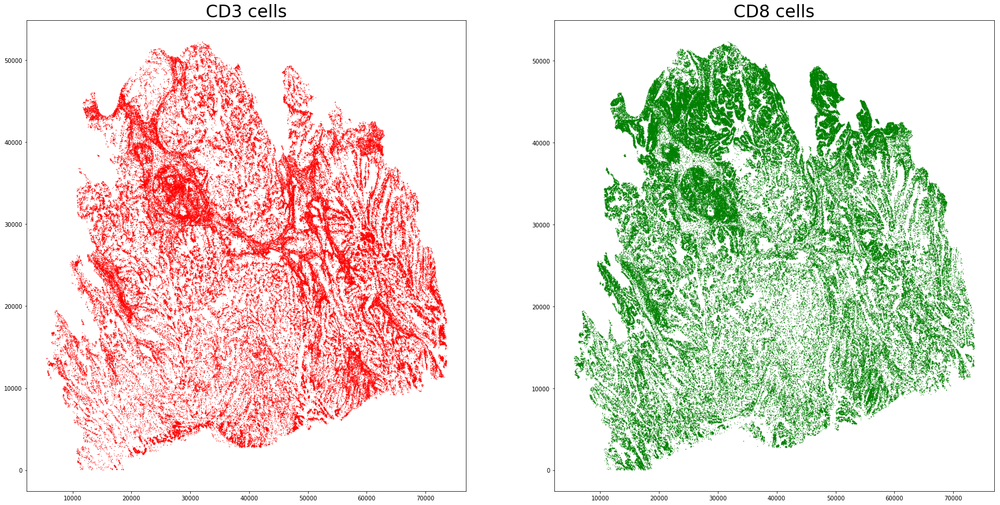

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 77/77 [00:08<00:00,  8.67it/s]


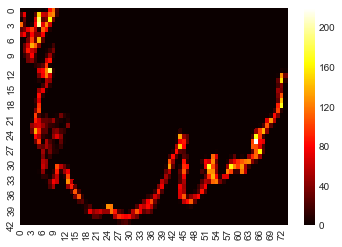

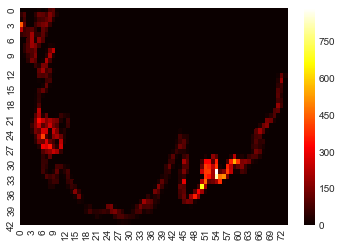

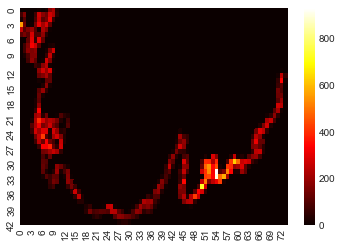

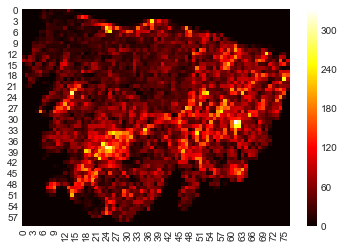

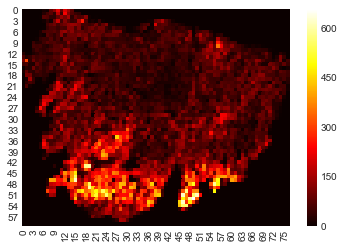

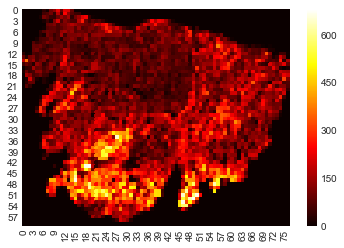

8it [1:28:23, 662.99s/it]

################### CODES ###################
0698
0698
0698
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[5824 5852  275  307    1    0] [4864 4882  899  917    0    1]


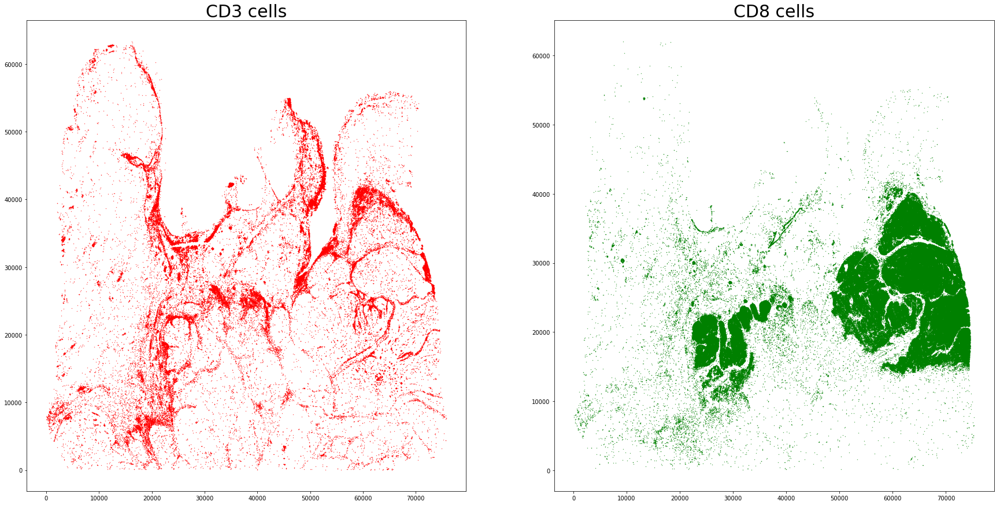

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[ 846  878 4695 4725    1    0] [5824 5852  275  307    1    0] [[  846   870  5829  5849     0     1]
 [  834   842  5833  5849     0     1]
 [  868   882  5937  5963     0     1]
 ...
 [60052 60076 42195 42217     0     1]
 [60124 60152 42231 42253     0     1]
 [60744 60766 42539 42561     0     1]] [4864 4882  899  917    0    1]


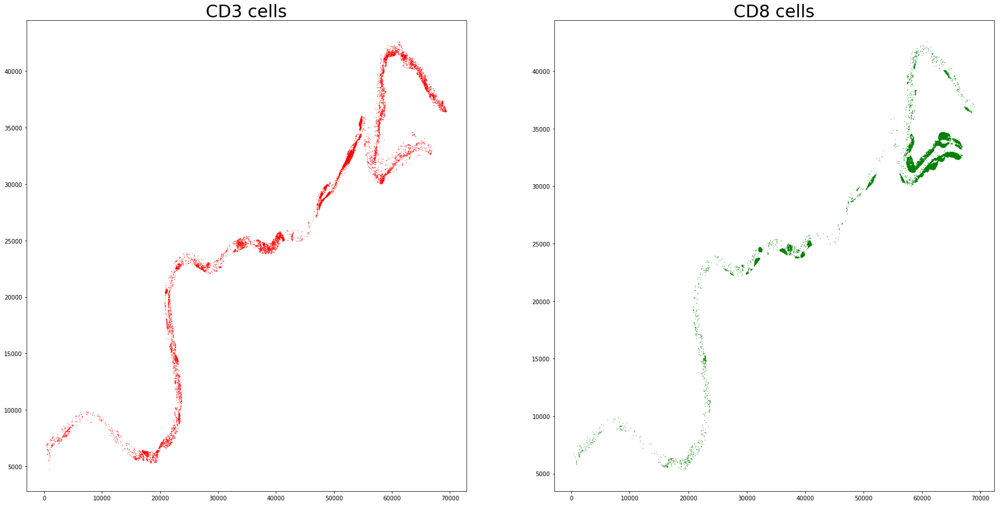

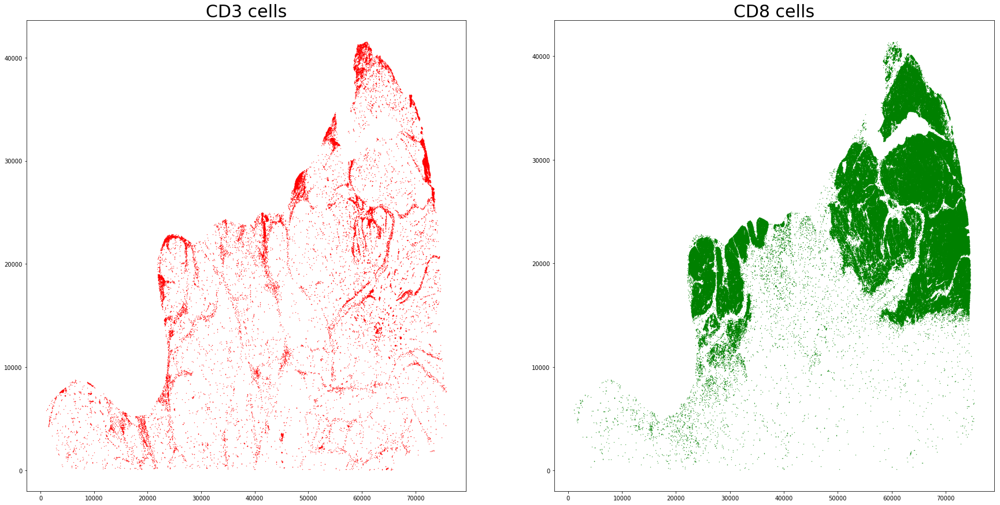

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 85/85 [00:06<00:00, 12.92it/s]

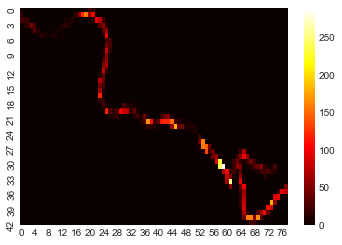

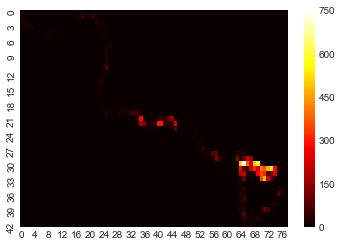

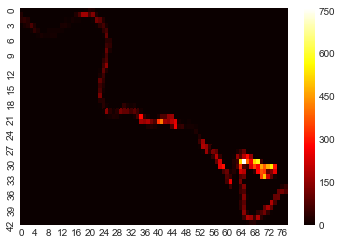

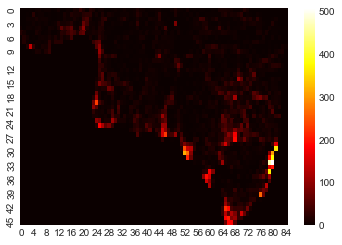

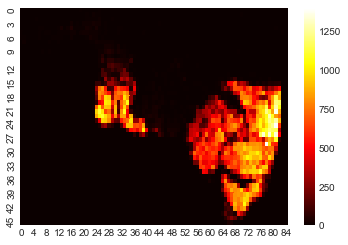

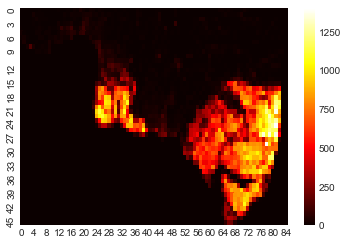

9it [1:33:09, 621.07s/it]

################### CODES ###################
0699
0699
0699
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[7604 7642   51   81    1    0] [7488 7516   51   73    0    1]


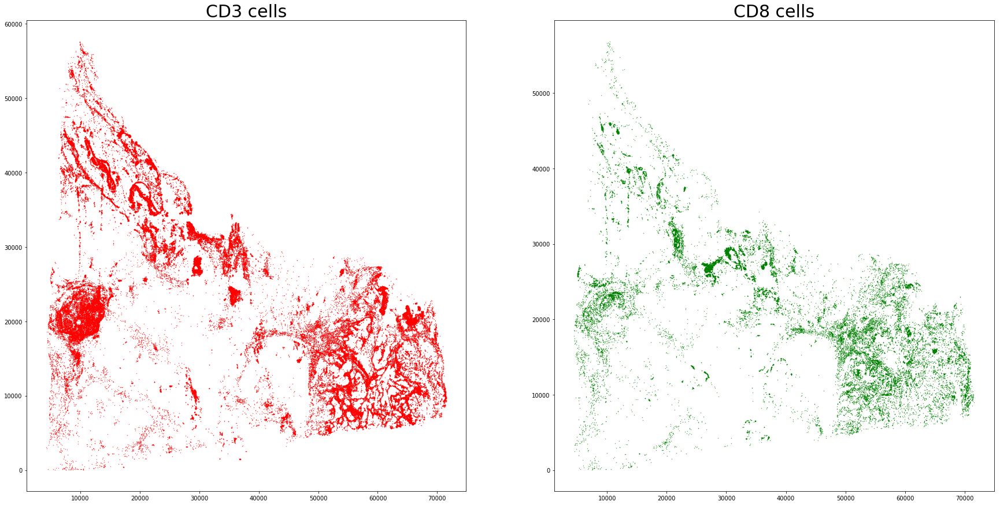

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[48368 48406  4643  4667     1     0] [51462 51490  4691  4721     1     0] [[48358 48380  4669  4695     0     1]
 [48440 48464  4751  4771     0     1]
 [48622 48644  4785  4805     0     1]
 ...
 [58948 58966 24241 24253     0     1]
 [58908 58930 24245 24265     0     1]
 [59102 59122 24249 24267     0     1]] [51160 51182  4819  4841     0     1]


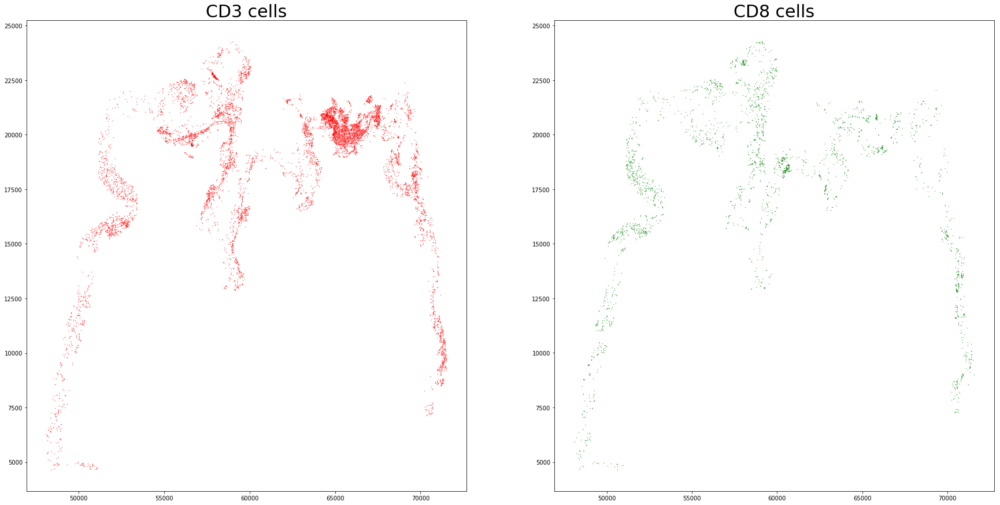

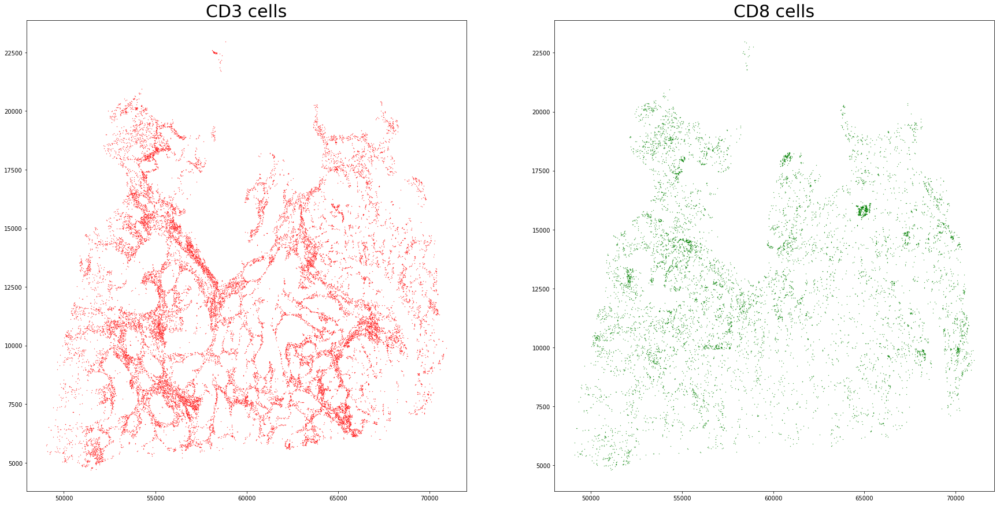


100%|██████████| 27/27 [00:00<00:00, 560.05it/s]

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 25/25 [00:00<00:00, 289.32it/s]

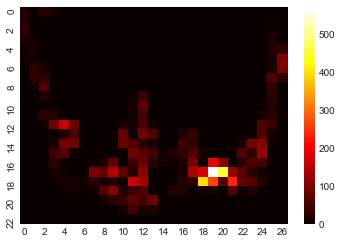

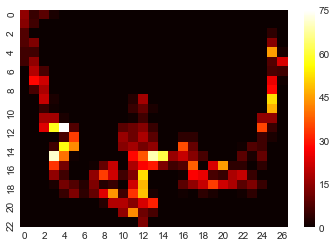

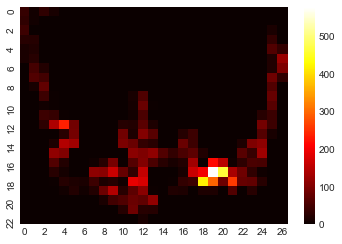

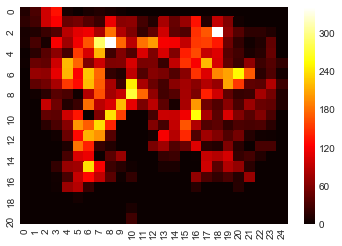

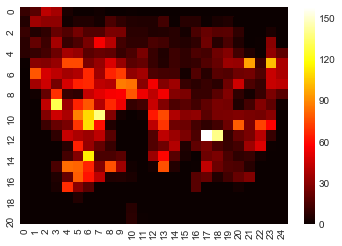

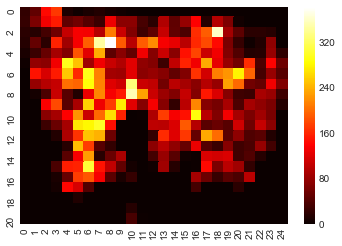

10it [1:34:33, 567.39s/it]

################### CODES ###################
0700
0700
00-1
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[53642 53688   195   235     1     0] [53468 53490   335   357     0     1]


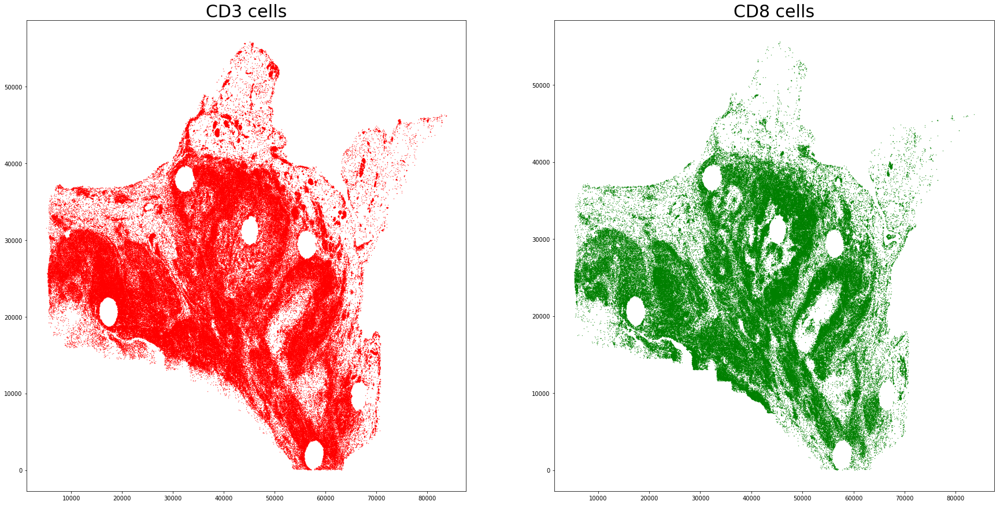

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[61518 61546  1571  1623     1     0] [61654 61678  3173  3201     1     0] [[61958 61974  1631  1645     0     1]
 [61748 61768  1637  1647     0     1]
 [61894 61914  1641  1671     0     1]
 ...
 [33626 33652 42011 42043     0     1]
 [33674 33704 42015 42033     0     1]
 [33708 33736 42019 42037     0     1]] [61598 61626  3187  3229     0     1]


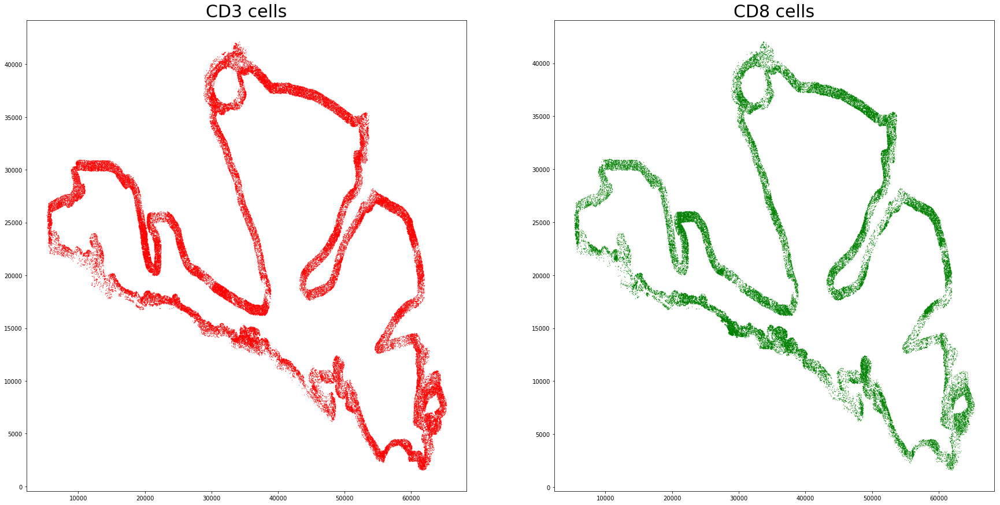

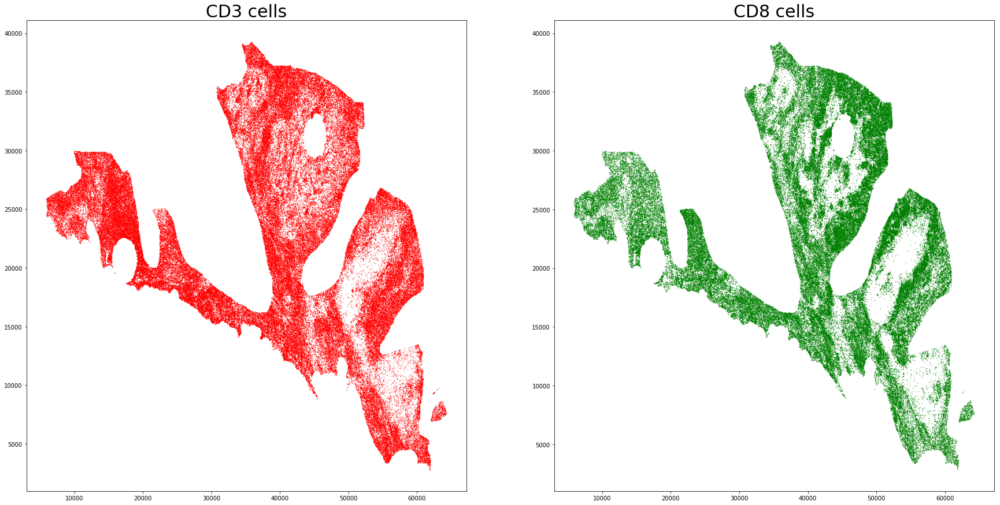

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 66/66 [00:04<00:00, 15.36it/s]


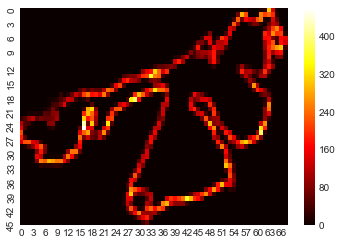

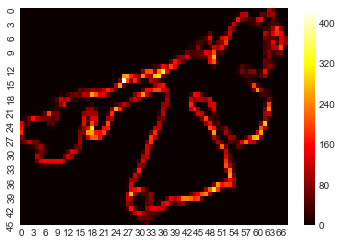

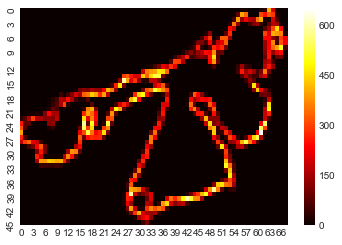

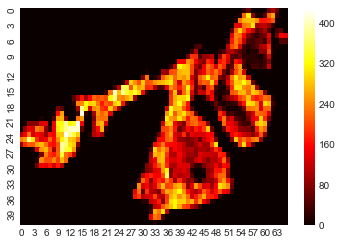

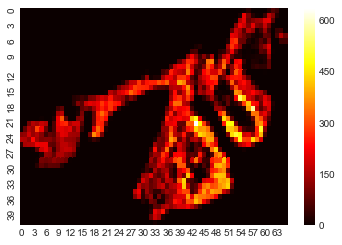

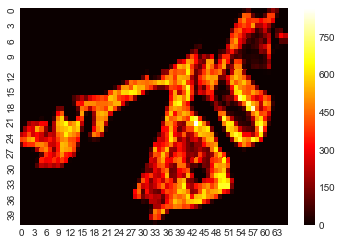

11it [1:44:22, 569.30s/it]

################### CODES ###################
0701
0701
0701
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[11996 12022  2449  2475     1     0] [11640 11666  2277  2307     0     1]


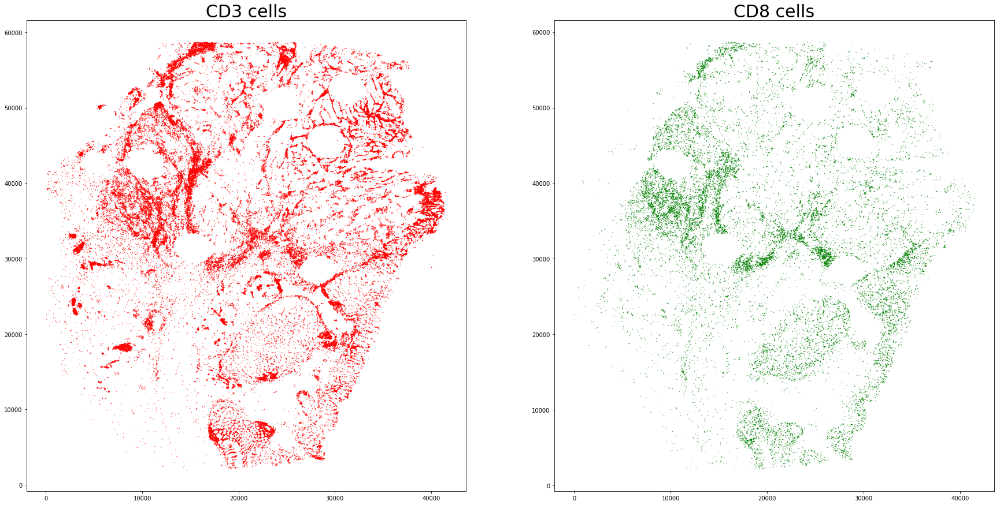

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[19120 19152  2127  2173     1     0] [19120 19142  2837  2863     1     0] [[19140 19164  2075  2091     0     1]
 [19108 19130  2177  2201     0     1]
 [18758 18784  2271  2291     0     1]
 ...
 [21914 21932 57969 57987     0     1]
 [22362 22378 57983 58003     0     1]
 [22128 22170 58195 58223     0     1]] [19126 19150  2917  2949     0     1]


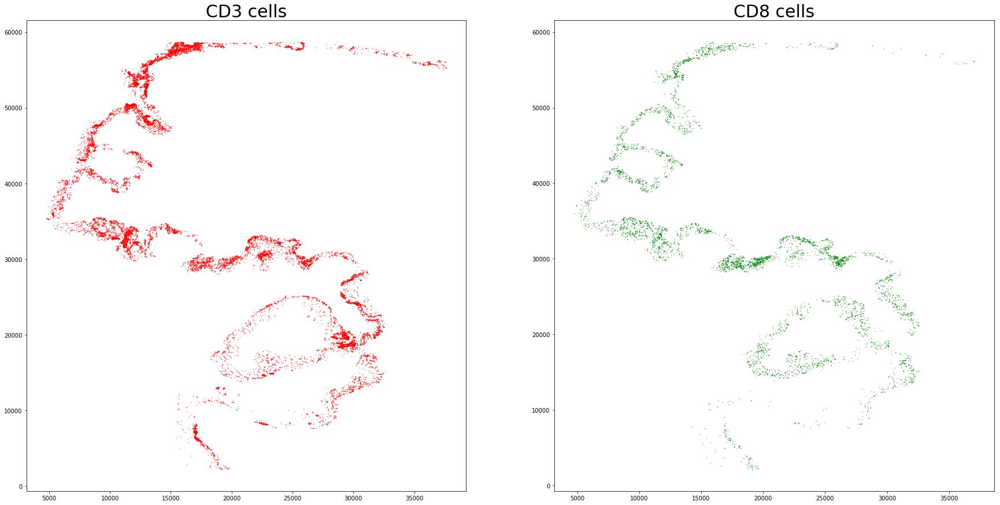

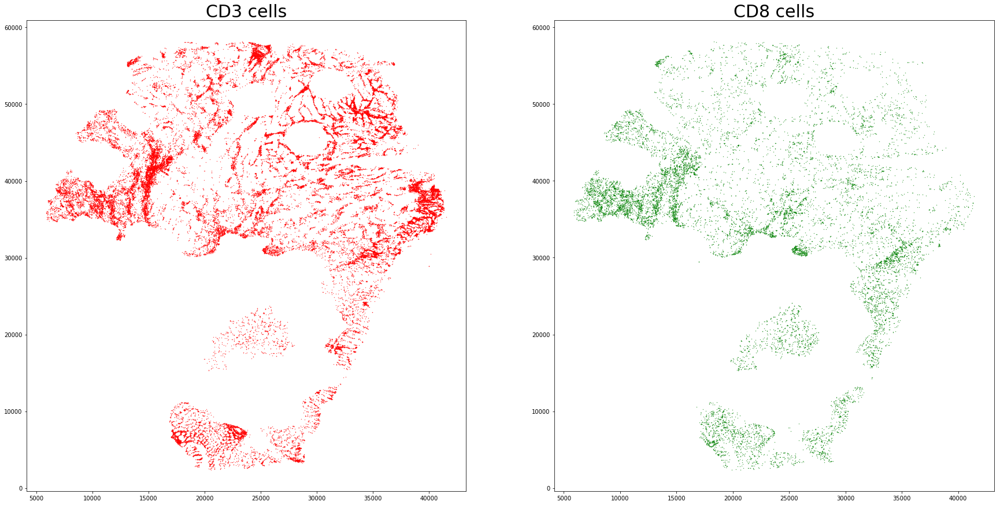

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 38/38 [00:00<00:00, 122.48it/s]

100%|██████████| 41/41 [00:00<00:00, 62.98it/s]

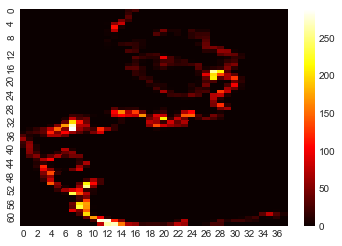

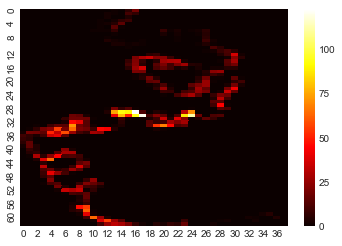

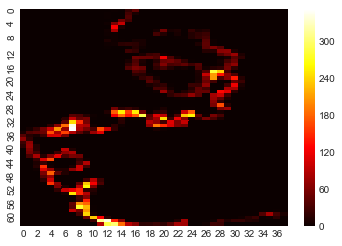

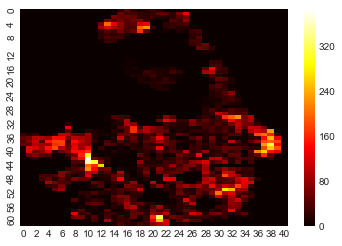

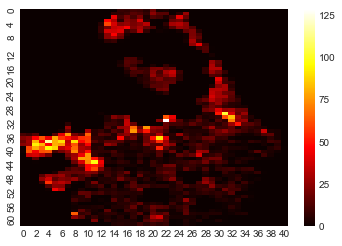

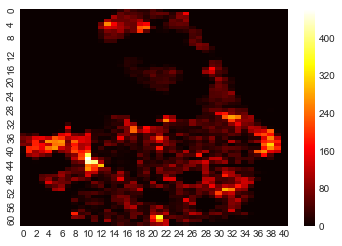

12it [1:46:48, 534.06s/it]

################### CODES ###################
0702
0702
0702
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[18592 18618  1456  1476     1     0] [18414 18438  1482  1506     0     1]


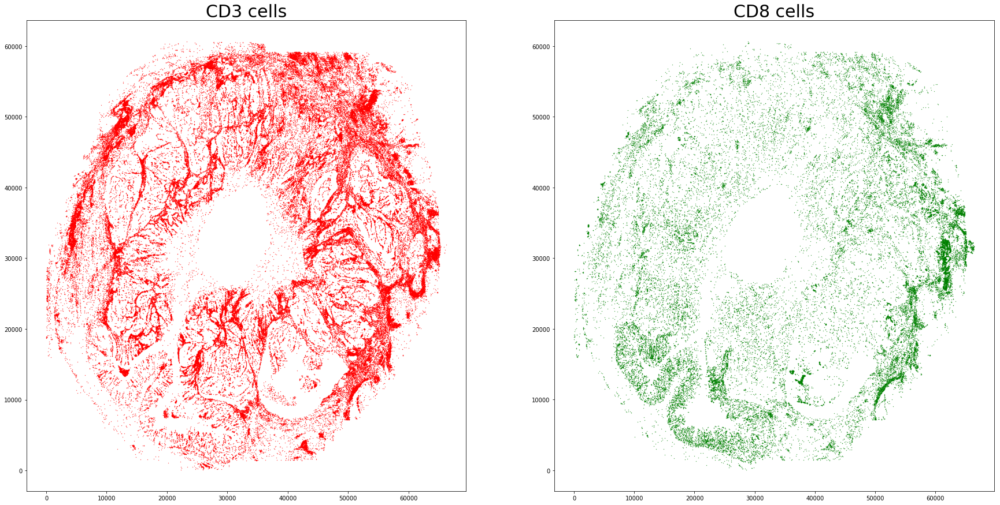

<class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
[26556 26588  1352  1380     1     0] [19494 19518  3150  3170     1     0] [[25648 25666  1362  1380     0     1]
 [26118 26142  1444  1464     0     1]
 [29364 29394  1028  1048     0     1]
 ...
 [27400 27434 58612 58648     0     1]
 [27690 27734 58630 58652     0     1]
 [27516 27564 58668 58714     0     1]] [19642 19670  2904  2926     0     1]


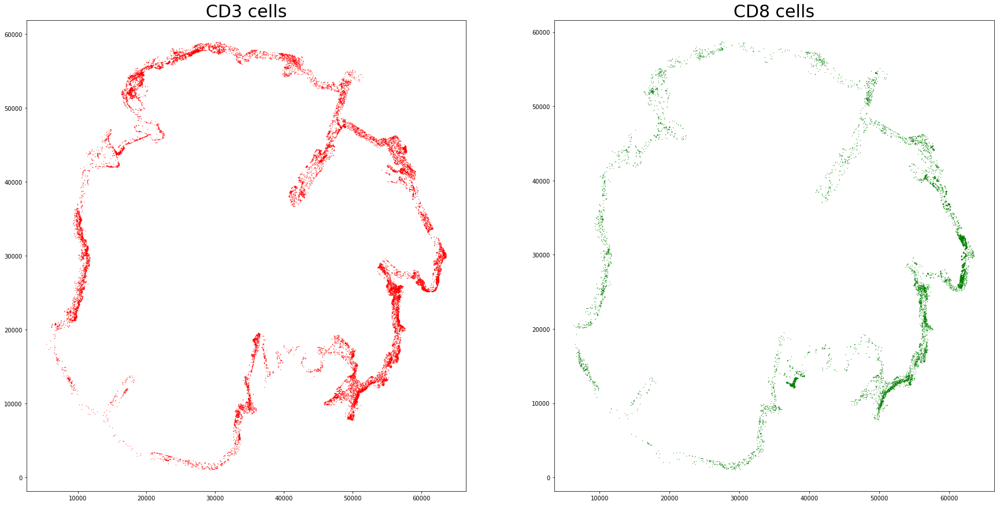

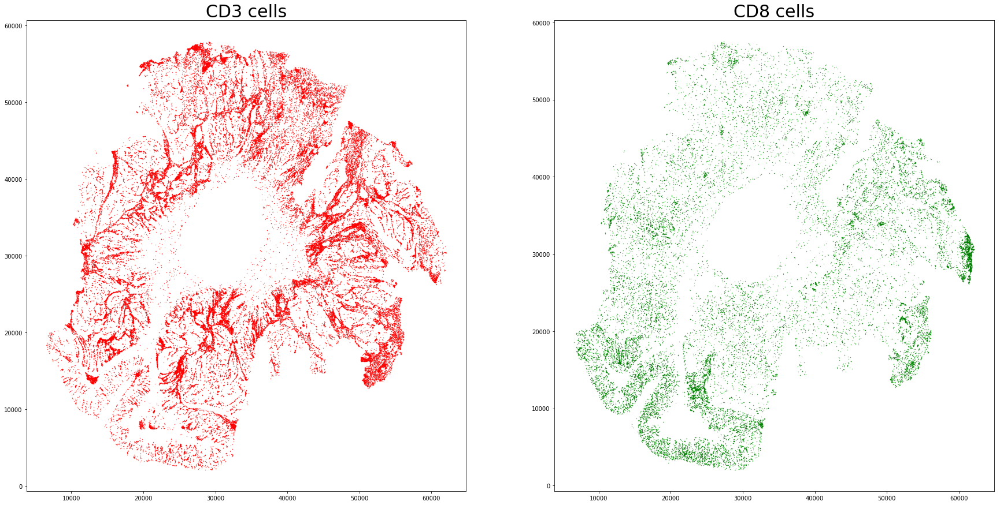

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
<class 'numpy.ndarray'> <class 'numpy.ndarray'>



100%|██████████| 63/63 [00:01<00:00, 35.91it/s]

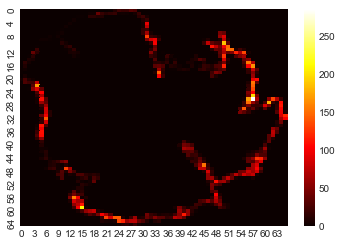

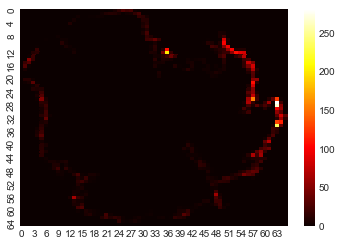

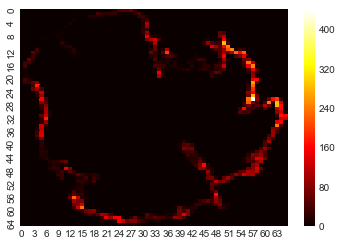

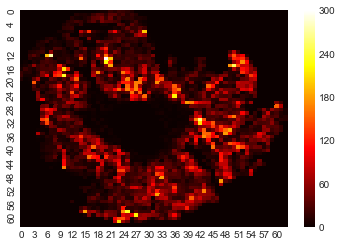

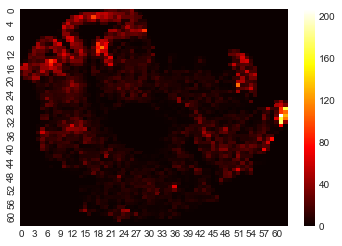

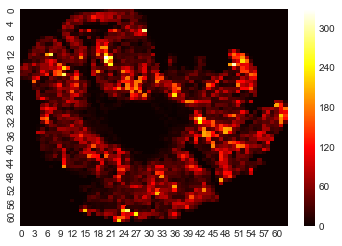

13it [1:50:59, 512.26s/it]

################### CODES ###################
0703
0703
0703
################### CODES ###################
<class 'numpy.ndarray'> <class 'numpy.ndarray'>
[18396 18402   646   660     1     0] [11632 11662   134   164     0     1]


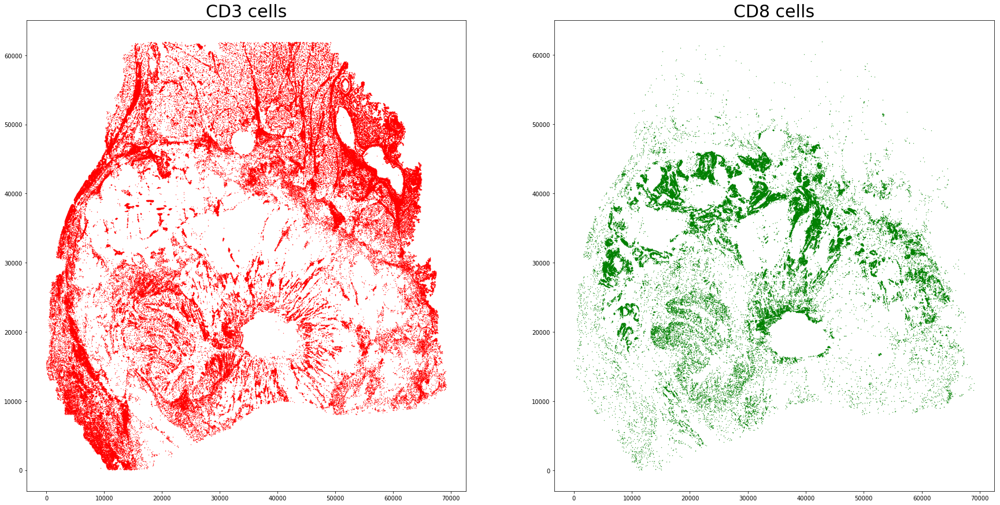

In [ ]:
raw_images, outcomes, t, d, cluster_range = get_heatmaps(m=114, d=50, t=886, display_plot=True, pretty_print=False)

In [52]:
raw_images.shape

(342,)